In [54]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
#import nltk
#from nltk.stem import WordNetLemmatizer
import seaborn as sns
import folium
from folium.plugins import MarkerCluster
import xgboost as xgb

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import chi2
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.externals import joblib

pd.options.mode.chained_assignment = None

Populating interactive namespace.

In [3]:
data=pd.read_excel(os.getcwd()+'\\Dataset\\globalTerrorDB.xlsx')

# Inspect data
print(data.info())
print(data.columns)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: datetime64[ns](1), float64(55), int64(22), object(57)
memory usage: 187.1+ MB
None
Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)


After reading the codebook associated with the dataset from the [Global Terrorism Database](https://www.start.umd.edu/gtd/downloads/Codebook.pdf) and inspecting the dataset we can begin by dropping data that won't contribute to the model fit. Let's do that by only selecting features that are "complete", meaning we have a large portion of the database that is not filled with NaN or unknown values for said features. Also, we can remove duplicate features, such as country and country_text.

In [4]:
idx_data=data.eventid

select=['iyear','imonth','iday','country', 'region',
        'latitude', 'longitude', 'summary', 'alternative',
        'multiple', 'success', 'suicide', 'attacktype1',
        'targtype1', 'natlty1', 'gname','motive','nperps',
        'nperpcap', 'claimed', 'claimmode', 'weaptype1',
        'weapsubtype1', 'weapdetail', 'nkill', 'nkillus',
        'nkillter', 'nwound', 'nwoundus','nwoundte', 'property',
        'propextent','propvalue', 'ishostkid', 'nhostkid', 'nhostkidus',
        'nhours','ndays', 'divert', 'kidhijcountry','ransom', 'ransomamtus',
        'ransompaidus', 'hostkidoutcome', 'nreleased',
        'addnotes', 'INT_LOG', 'INT_IDEO', 'INT_MISC', 'INT_ANY'
        ]

df=data[select]

After selecting our data, we want to remove any groups that have performed a small number of terror attacks, under 3. These groups are a small percentage of data that can act as noise to a model that is attempting to fit over 1300 classes.

In [9]:
df=data[select]
gname_counts=df['gname'].value_counts()
print(gname_counts.tail())
gname_list=gname_counts[gname_counts >= 3].index.tolist()
df=df[df['gname'].isin(gname_list)]

Basque Refugee Support Group            1
Armed People's Units                    1
Falangist Vanguard                      1
Council for the Destruction of Order    1
Martyr Ahmad Alishuay B Group           1
Name: gname, dtype: int64


After cleansing these observations, we can begin inspecting the dataset through data visualization and look for interesting information described through visualizations that may be more difficult to see through text and code.

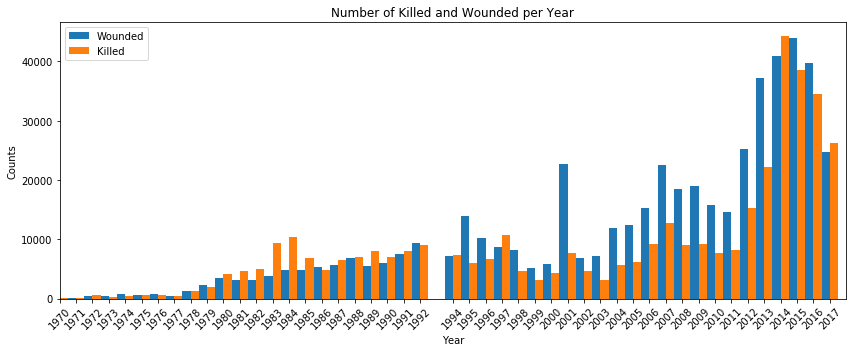

In [11]:
# DATA VISUALIZATION
# First examine how many wounded and killed per year
plt.figure(figsize=(12,5))
g1=df.groupby(['iyear'])['nwound'].sum().reset_index(name='counts')
idx=g1['iyear']
width = np.min(np.diff(idx))/2
y1=g1['counts']
rects1=plt.bar(idx-width/2,y1,width,label='Wounded')


g2=df.groupby(['iyear'])['nkill'].sum().reset_index(name='counts2')
y2=g2['counts2']
rects2=plt.bar(idx+width/2,y2,width,label='Killed')
plt.xlabel('Year')
plt.ylabel('Counts')
plt.xlim(1970, 2018)
plt.xticks(idx, rotation=45)
plt.legend()
plt.title('Number of Killed and Wounded per Year')
plt.tight_layout()
plt.show()

One main thing that I was curious about first was what the number of wounded and killed per year in these incidents looked like. After plotting this bar graph, it's immediately apparent that a gap exists for the year 1993. When we read the codebook, see that the files documenting the terrorist attacks in the year 1993 were lost:

> In addition, users familiar with the GTD’s Data Collection Methodology are aware that incidents of terrorism from 1993 are not present in the GTD because they were lost prior to START’s compilation of the GTD from multiple data collection efforts. Several efforts were made to re-collect these incidents from original news sources. Unfortunately, due to the challenges of retrospective data collection for events that happened more than 20 years ago, the number of 1993 cases for which sources were identified is only 15% of estimated attacks. As a consequence we exclude all 1993 attacks from the GTD data to prevent users from misinterpreting the low frequency in 1993 as an actual count.

Aside from that, we can see that over time, the number of people either killed or wounded in terror incidents has increased steadily from 1970 to 2014 while experiencing some peaks and valleys in between. After 2014, the number enters another valley, hopefully signifying that the number of terror attacks are decreasing. Let's look at that statistic now to verify our assumption.

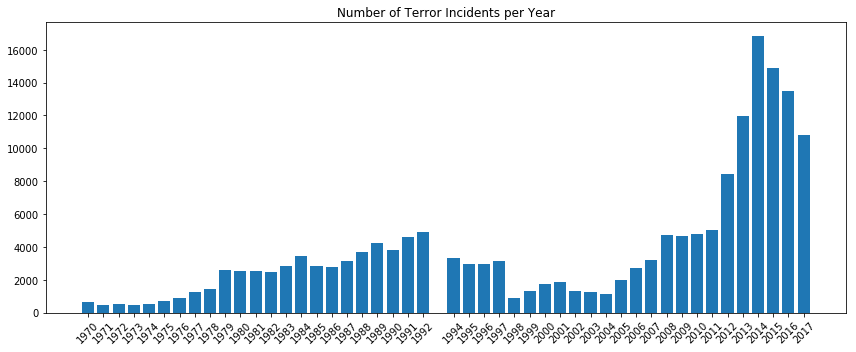

In [12]:
# Let's inspect the number of terror incidents per year

g3=df.groupby(['iyear']).agg('count')
counts=g3['imonth']
assert counts.sum()==179016, 'Counts not equal to size of dataset'
plt.figure(figsize=(12,5))
plt.bar(g3.index, counts)
plt.xticks(idx, rotation=45)
plt.title('Number of Terror Incidents per Year')
plt.tight_layout()
plt.show()

We verify our assumption here and see that the total number of incidents happening per year peaks at 2014 and seems to be entering a trough towards the end of the current decade. We can see that the three counts are correlated but how correlated are they? Let's a quick look.

            nwoundyear  nkillyear  incidents
nwoundyear    1.000000   0.908347   0.893985
nkillyear     0.908347   1.000000   0.966027
incidents     0.893985   0.966027   1.000000


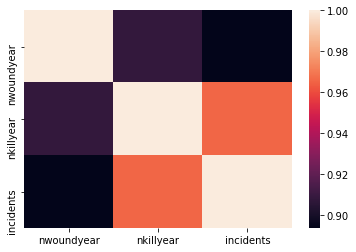

In [13]:
hmap=pd.DataFrame()
hmap['nwoundyear']=g1['counts']
hmap['nkillyear']=g2['counts2']
hmap['incidents']=g3['imonth'].values
sns.heatmap(hmap.corr())
print(hmap.corr())
plt.show()

Non-surprisingly, we can see these three features are heavily positively correlated with a Pearson correlation coefficient very close to 1. Let's take a look at our selection of data and see if we can find any other features that are also heavily correlated that aren't so obvious.

Positive Correlation: 
INT_LOG   INT_IDEO    0.996356
INT_IDEO  INT_LOG     0.996356
INT_ANY   INT_IDEO    0.893357
INT_IDEO  INT_ANY     0.893357
INT_ANY   INT_LOG     0.890692
dtype: float64
Negaitve Correlation: 
nhours      longitude        -0.312747
longitude   nhours           -0.312747
propextent  property         -0.326083
property    propextent       -0.326083
ndays       hostkidoutcome   -0.475169
dtype: float64


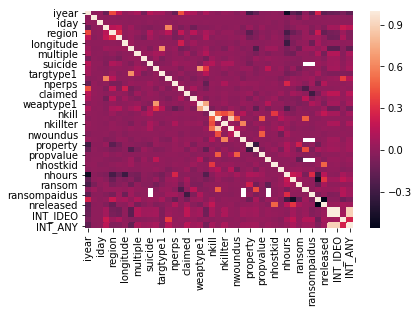

In [42]:
corr_df=df.corr()
sns.heatmap(corr_df)
uns_corr=corr_df.unstack()
ord_corr=uns_corr.sort_values(ascending=False)
print('Positive Correlation: \n{}' .format(ord_corr[(ord_corr!=1.0) & (ord_corr>0.5)][0:5]))
print('Negaitve Correlation: \n{}' .format(ord_corr[(ord_corr!=1.0) & (ord_corr<-0.3)][0:5]))
plt.show()

We can see that the heavily positively correlated features are the INT features, which deal with international information about the terror incidents. The two important ones are INT_IDEO and INT_LOG. IDEO is a feature which flags whether a group attacked a target of a different nationality, and LOG is a feature which indicates whether a group crossed a border to initiate an attack. This makes sense because borders typically separate people of different nationalities.

As for negatively correlated features, it seems that property and propextent are negatively correlated. When reading the codebook, we can see that propextent gives higher values for lower amount of damage to property, e.g. 1 for catastrophic damage and 3 for minor damage. This seems to indicate that these two features are actually positively correlated and the data should be readjusted to reflect higher flag numbers for higher property damage values. The ndays and hostkidoutcome features make sense because as number of days increases, the less likely hostages are to be rescued.

Moving on to more visualization, I was also interested in the number and percentage of attacks done by the most frequently appearing groups. I created a series of bar graphs that show, by decade, which groups are responsible for the most terror attacks.

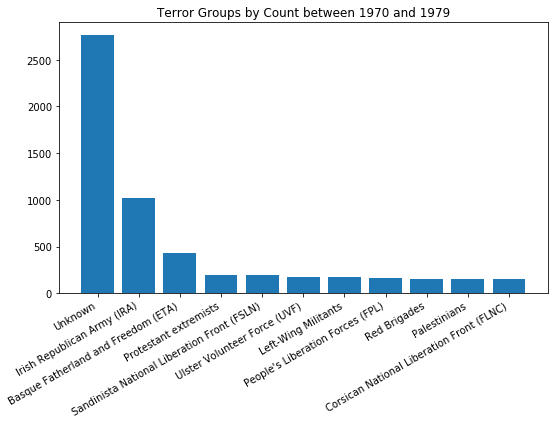

The top 10 groups performed 29.55% of incidents


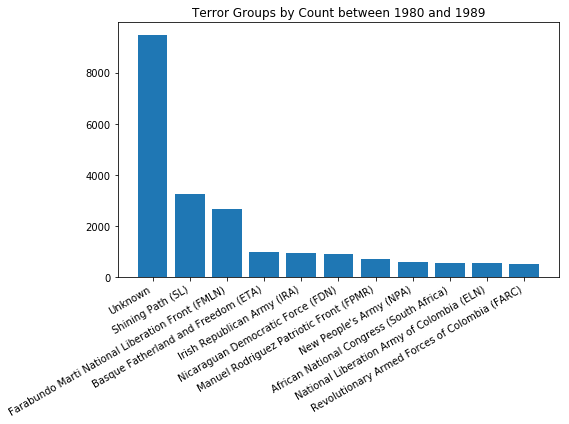

The top 10 groups performed 38.05% of incidents


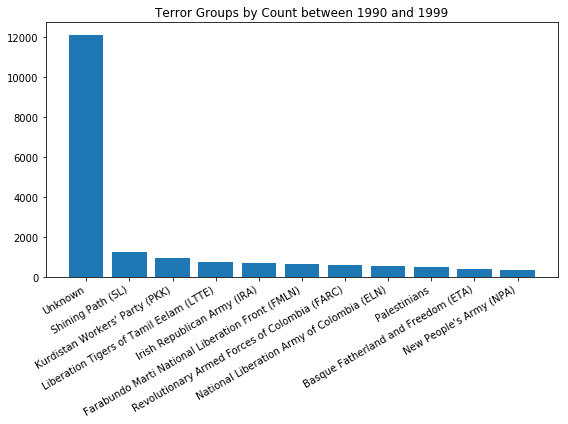

The top 10 groups performed 24.2% of incidents


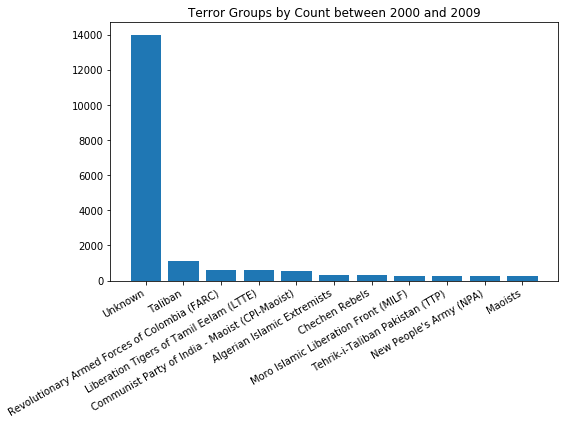

The top 10 groups performed 18.35% of incidents


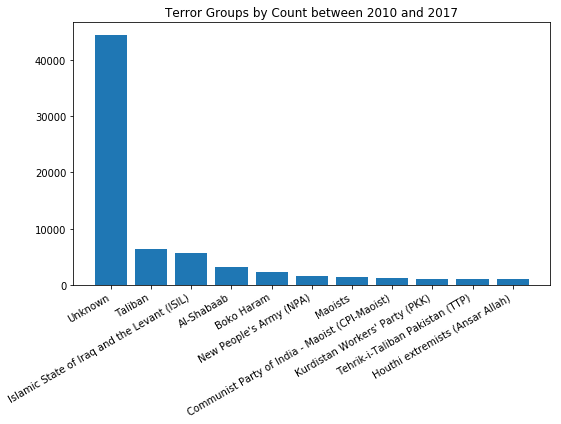

The top 10 groups performed 29.06% of incidents


In [47]:
def incidentGraph(year_beginning, year_ending):
    '''Creates a bar graph of the incidents between specified years. Format:
        incidentGraph(year_beginning, year_ending)'''
    dec=df.loc[df.iyear.between(year_beginning, year_ending)]
    g=dec.groupby(['gname'])['iyear'].agg('count')
    g=g.sort_values(ascending=False)
    plt.figure(figsize=(8,6))

# We have a lot of incidents that are unknown. More unknown incidents than
# known ones. If we look at just the first 10 known actors, then we can see
# a better layout of the known terrorist groups.

    plt.bar(g[0:11].index, g[0:11])
    plt.xticks(rotation=30,horizontalalignment='right')
    plt.title('Terror Groups by Count between %s and %s'
              % (year_beginning, year_ending))
    plt.tight_layout()
    plt.show()
    per=g[1:11].sum()/g.sum() *100
    print('The top 10 groups performed %s%% of incidents' % per.round(2))

incidentGraph(1970,1979)
incidentGraph(1980,1989)
incidentGraph(1990,1999)
incidentGraph(2000,2009)
incidentGraph(2010,2017)

We can see the top 10 groups perform a large number of the total incidents in any given decade. We ignore unknowns in our percent calculation because the number of terror attacks that are performed by an unidentified group dominates the count by group for any given decade.

We can see the main groups responsible for a large portion of the number of known group name incidents, over 18% by decade. Between 2000 and 2009, there seems to be a greater number of terrorist groups performing attacks. This might be because of the rapid rise in news reporting on terrorism in the US and other developed countries. We can perform A/B testing on dates before and after 9/11/2001 to see if this event triggered a larger number of people to incite terror attacks around the world. Let's see which regions these incidents from the top ten are performed in.

In [56]:
def map_decade(year1,year2):
    '''Creates a map of the terror attacks between any two given 
    years. Format is map_decade(year_beginning, year_ending)'''
    dec=df.loc[df['iyear'].between(year1,year2)]
    ten=dec.groupby(['gname'])['iyear'].agg('count')
    ten=ten.sort_values(ascending=False)
    top_ten_data=dec.loc[(dec['gname'].isin(ten[1:11].index))]
    top_ten_data['gname']=top_ten_data['gname'].str.replace("'","") #I can't believe that it doesn't work without this.
    loc_data=top_ten_data[['longitude','latitude','gname']].fillna(0)
    loc_data=loc_data.loc[loc_data['latitude']!=0]
    marker_data=list(zip(loc_data['latitude'], loc_data['longitude'],
                       loc_data['gname']))

    locations=list(zip(loc_data['latitude'], loc_data['longitude']))

    popups = ['lat:{}<br>lon:{}<br>group:{}'.format(lat, lon, group) for (lat,
              lon, group) in marker_data]

    map1=folium.Map(location=[np.mean(loc_data['longitude']),
                    np.mean(loc_data['latitude'])], zoom_start=4,
                    tiles='Mapbox Bright')

    marker_cluster=MarkerCluster(locations=locations,
                                 popups=popups).add_to(map1)

    map1.save(os.path.join('results', 'terror_map.html'))
    return map1

map1=map_decade(2010,2017)
map1

Let's begin preprocessing our dataset for our model. I want to include the text data in the *summary*, *addnotes*, and *motive* features as I believe these will increase our model precision considerably. I've cleaned the text data through regular expressions and lemmatized the text in the three features and joined them together as a semi-corpus of sorts for each "document" being an observation in the dataframe. I saved the resulting dataframe for time's sake and loaded it accordingly as shown below. I ran this before thinking about "noisy" observations of groups that peform less than 3 counts of attacks so I had to appropriately drop the "noisy" data. 

In [58]:
# PREPROCESSING
# The following code snippet has been run and result has been saved to
# save_lemmatized.csv. It took a whole night to run so I've commented it out
# for time's sake.

# Create function to remove punctuation, reduce whitespace to single space,
# lowercase, and lemmatize text data.

#def lemmatize_text(text):
#    '''Lemmatize text.'''
#    wnl=WordNetLemmatizer()
#    w_tokenizer = nltk.tokenize.WhitespaceTokenizer()
#    return [wnl.lemmatize(w,'v') for w in w_tokenizer.tokenize(text)]



#def text_preprocess(data):
#    '''Preprocesses text data in specified columns in dataframe.'''
#    text_df=data.astype('U')
#    lem_text=pd.DataFrame()
#
#    for col in text_df.columns:
#        print('working... now on %s' %text_df[col].name)
#        reg1=re.compile('[,\.!?"($)@:;~/-]')
#        reg2=re.compile('\d+')
#        reg3=re.compile('\s+')
#        for row in range(len(text_df[col])):
#            if text_df[col][row]!='NaN':
#                text_df[col][row]=reg1.sub(' ', text_df[col][row])
#                text_df[col][row]=reg2.sub(' ', text_df[col][row])
#                text_df[col][row]=reg3.sub(' ', text_df[col][row]).strip()
#                text_df[col][row]=text_df[col][row].lower()
#
#        lem_text[col]=text_df[col].apply(lemmatize_text)
#
#        for row in range(len(lem_text[col])):
#            if lem_text[col][row]!=['nan']:
#                text_in_row=' '.join(lem_text[col][row])
#                lem_text.loc[row, col]=text_in_row
#            else:
#                lem_text.loc[row,col]=np.nan
#    return lem_text
#
#text_cols=df[['summary','motive','addnotes']][0:181691]
#lem_text=text_preprocess(text_cols)
#lem_text.to_csv('save_lemmatized.csv')

lem_text=pd.read_csv('save_lemmatized.csv',index_col=0)
lem_text['gname']=df['gname']
lem_text=lem_text[lem_text['gname'].isin(gname_list)]

# Let's factorize our group_id to prepare for model creation. Save dictionaries
df['group_id'] = df['gname'].factorize()[0]
gname_id_df=df[['gname', 'group_id']].drop_duplicates().sort_values('group_id')
gname_to_id_dict=dict(gname_id_df.values)
id_to_gname_dict=dict(gname_id_df[['group_id','gname']].values)

#join text for tfidf

lem_text['joined']=lem_text['summary'].map(str)+' '+lem_text['motive'].map(str)
lem_text['joined']+=' '+lem_text['addnotes'].map(str)

lem_text['joined']=lem_text['joined'].map(lambda x: re.sub('nan', '', x))

I wanted to vectorize this new data to be able to combine it with the numerical data in the dataframe such that all data would then be of type *int* or *float*. I thought to use the TF-IDF vectorizer and perform a chi-squared test to see if the resultant vectorized words seemed to be correlated to the terror groups associated with them. I used *stop_words* as english to remove common english "garbage" words, set *max_features* to 2000 as I did not want computationally expensive vectorized features, we just need enough to mark a difference and help our model learn between one group and another. *min_df* is set to 2% so that we can remove some more noisy garbage words from our vectorized text features.

In [67]:
#tfidf
tfidf = TfidfVectorizer(stop_words='english', max_features=2000,
                        ngram_range=(1,2), norm='l2', min_df=0.02)
features = tfidf.fit_transform(lem_text.joined.astype('U')).toarray()
labels = df.group_id
features.shape

# Perform chi2 to see top 3 unigrams and bigrams from tfidf vectorizer. Do this
# to get a sense if vectorized words are relevant to groups.

def chi2_test(corpus, feats):

    counter=0
    for gname, group_id in sorted(corpus.items()):
        counter+=1
        if counter == 10:
            break
        else:
            features_chi2 = chi2(feats, labels == group_id)
            indices = np.argsort(features_chi2[0])
            feature_names = np.array(tfidf.get_feature_names())[indices]
            unigrams = [v for v in feature_names if len(v.split(' ')) == 1]
            bigrams= [v for v in feature_names if len(v.split(' ')) ==2]
            print("# '{}':".format(gname))
            print("  . Most correlated unigrams:\n. {}"
              .format('\n. '.join(unigrams[-3:])))
            print("  . Most correlated bigrams:\n. {}"
              .format('\n. '.join(bigrams[-3:])))

chi2_test(gname_to_id_dict, features)

# '1 May':
  . Most correlated unigrams:
. responsibility
. claim
. attack
  . Most correlated bigrams:
. responsibility incident
. group claim
. claim responsibility
# '14 K Triad':
  . Most correlated unigrams:
. set
. government
. believe
  . Most correlated bigrams:
. claim responsibility
. relate attack
. casualties report
# '14th of December Command':
  . Most correlated unigrams:
. responsibility
. claim
. attack
  . Most correlated bigrams:
. responsibility incident
. group claim
. claim responsibility
# '16 January Organization for the Liberation of Tripoli':
  . Most correlated unigrams:
. responsibility
. claim
. attack
  . Most correlated bigrams:
. responsibility incident
. group claim
. claim responsibility
# '1st of May Group':
  . Most correlated unigrams:
. responsibility
. claim
. attack
  . Most correlated bigrams:
. responsibility incident
. group claim
. claim responsibility
# '2 April Group':
  . Most correlated unigrams:
. responsibility
. claim
. attack
  . Most

It seems that computing the chi-squared stats initially fails but after inspecting the groups individually, we can see that the ones that return the same:

>. responsibility
. claim
. attack

unigrams and similar bigrams are the ones without text data. This suggests that the tfidf works for the observations that have text data, which is all chi-squared is here to confirm.

Now I want to determine which is the best model for our data. I created a function to help determine that below.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:605: Warning: The least populated class in y has only 1 members, which is too few. The minimum number of members in any class cannot be less than n_splits=5.
  % (min_groups, self.n_splits)), Warning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:605: Warning: The least populated class in y has only 1 members, which is too few. The minimum number of members in any class cannot be less than n_splits=5.
  % (min_groups, self.n_splits)), Warning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:605: Warning: The least populated class in y has only 1 members, which is too few. The minimum number of members in any class cannot be less than n_splits=5.
  % (min_groups, self.n_splits)), Warning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:605: Warning: The least populated class in y has only 1 members, which is too few. The mi

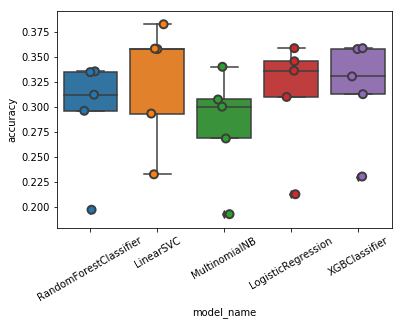

In [77]:
# test which model performs best with text data
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 

def model_testing(features, labels):
    param={'max_depth': 3,
       'eta': 0.3,
       'silent': 1,
       'n_jobs':3,
       'objective': 'multi:softmax',
       'num_class': labels.nunique(),
       'random_state':42,
       'num_round':30}
    models = [
        RandomForestClassifier(n_estimators=200,
                                   max_depth=3, random_state=42),
        LinearSVC(),
        MultinomialNB(),
        LogisticRegression(solver='sag', n_jobs=2, tol=0.1,
                          random_state=42),
        xgb.XGBClassifier(**param)
            ]
    CV = 5
    cv_df = pd.DataFrame(index=range(CV * len(models)))
    entries = []
    for model in models:
        model_name = model.__class__.__name__
        accuracies = cross_val_score(model, features[0:2000], labels.iloc[0:2000]
                               , cv=CV)
        for fold_idx, accuracy in enumerate(accuracies):
            entries.append((model_name, fold_idx, accuracy))
            cv_df = pd.DataFrame(entries, columns=['model_name', 'fold_idx',
                                                   'accuracy'])

    ax=sns.boxplot(x='model_name', y='accuracy', data=cv_df)
    plt.setp(ax.get_xticklabels(), rotation=30)
    sns.stripplot(x='model_name', y='accuracy', data=cv_df,
              size=8, jitter=True, edgecolor="gray", linewidth=2)
    plt.savefig('results\model_comparison_small_sample.png')
    #plt.show()


model_testing(features, labels)

In [73]:
labels.value_counts().tail()

1009    3
660     3
188     3
1211    3
1279    3
Name: group_id, dtype: int64

Despite the warnings thrown about the population of the classes in y and what I think is false positive warning as per the value_counts of the labels, we can see that the best model for text features is tied between XGBoost and LinearSVC. However, I'd like to use XGBoost both for practice with it and for it's ability to "learn" what to do with nan values and zero values. Let's continue preprocessing our data.

In [78]:
df=df.replace([-9,-99], np.nan).reset_index(drop=True)

features=pd.DataFrame(features).reset_index(drop=True)

df=pd.concat([df,features],axis=1)


known=df.loc[df['group_id']!=1].reset_index()
unknown=df.loc[df['group_id']==1].reset_index()

known=known.drop([x for x in known.columns if known[x].dtype=='object'],
                 axis=1)
unknown=unknown.drop([x for x in unknown.columns if unknown[x].dtype=='object'],
                     axis=1)

known_group_id=known['group_id']
known.info()
unknown.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96234 entries, 0 to 96233
Columns: 250 entries, index to 204
dtypes: float64(238), int64(12)
memory usage: 183.6 MB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 82782 entries, 0 to 82781
Columns: 250 entries, index to 204
dtypes: float64(238), int64(12)
memory usage: 157.9 MB


Drop object columns as we have vectorized features for them now. Then fix issues with negative values as NaN as specified in the codebook. Also verify that the dtypes of the features in each dataframe are *int* and *float*

In [79]:
x_train, x_test, y_train, y_test= train_test_split(
        known.drop(['group_id'], axis=1),
        known_group_id, test_size=0.2, random_state=42)

Separate our data into train and test sets. The *unknown* dataframe will become our holdout data on which we predict our final data on. The *known* dataframe will become our train and test sets in which we get an accuracy score from.

In [82]:
# The following code snippet has been run and the model has been saved to clf_model.pkl.

#param={'max_depth': 3,
#       'eta': 0.3,
#       'silent': 1,
#       'n_jobs':3,
#       'objective': 'multi:softmax',
#       'num_class': 1340,
#       'random_state':42,
#       'num_round':30}

#clf=xgb.XGBClassifier(**param)
#clf.fit(x_train,y_train, verbose=True)
#joblib.dump(clf, 'clf_model.pkl', compress=True)

In [80]:
clf=joblib.load('results\clf_model.pkl')
y_pre=clf.predict(x_test)
print(accuracy_score(y_test, y_pre))
print(classification_report(y_test, y_pre))

0.6303319997921754
             precision    recall  f1-score   support

          0       0.00      0.00      0.00        15
          2       0.00      0.00      0.00        21
          3       0.00      0.00      0.00        12
          5       0.00      0.00      0.00         5
          6       0.00      0.00      0.00        31
          7       0.00      0.00      0.00         3
          8       0.00      0.00      0.00         4
          9       0.00      0.00      0.00         9
         10       0.00      0.00      0.00        16
         11       0.00      0.00      0.00        23
         12       0.00      0.00      0.00         1
         13       0.77      0.85      0.81       548
         14       0.00      0.00      0.00         3
         15       0.00      0.00      0.00        30
         16       0.00      0.00      0.00         1
         17       0.00      0.00      0.00         1
         18       0.00      0.00      0.00         8
         19       0.00    

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


Our accuracy score with our model received an accuracy_score of 63% with an average precision, recall, and f1-score of 54%, 63%, and 57%. This indicates that our model had a higher proportion of actual positives that was identified correctly than the proportion of positive identifications that was actually correct. We really want to look at the balanced accuracy statistic which is defined as (TPR + TNR)/2. Since TPR=TNR and TPR=Recall, we simply look for an average balanced accuracy score of 63%.

We can further run a prediction on our holdout set of data but without any real labels for our holdout set, I see no reason to do so. With an accuracy score of 63%, the output of the model wouldn't be very good, considering there are over 80000 entries we need to predict for.